<a href="https://colab.research.google.com/github/Monks-team/prediction_Algorithm/blob/master/Analytics_of_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
file = r'/content/drive/My Drive/data/us-counties.csv'
df = pd.read_csv(file)

In [3]:
df.head()

,date,county,state,fips,cases,deaths
0,2020-01-21,Snohomish,Washington,53061.0,1,0
1,2020-01-22,Snohomish,Washington,53061.0,1,0
2,2020-01-23,Snohomish,Washington,53061.0,1,0
3,2020-01-24,Cook,Illinois,17031.0,1,0
4,2020-01-24,Snohomish,Washington,53061.0,1,0


In [4]:
df = df.replace('Unknown', np.nan)

In [5]:
df['county'].isna().sum() 

3395

In [6]:
df = df[df['county'].notna()]

In [7]:
df.shape

(363304, 6)

In [8]:
df['date'] = df['date'].apply(pd.to_datetime)

In [9]:
regions = {'Maine':'Northeast',' Massachusetts':'Northeast', 'Rhode Island':'Northeast', 'Connecticut':'Northeast', 'New Hampshire':'Northeast', 
 'Vermont':'Northeast', 'New York':'Northeast', 'Pennsylvania':'Northeast', 'New Jersey':'Northeast', 'Delaware':'Northeast', 
 'Maryland':'Northeast','West Virginia':'Southeast', 'Virginia':'Southeast', 'Kentucky':'Southeast', 'Tennessee':'Southeast', 'North Carolina':'Southeast', 
 'South Carolina':'Southeast', 'Georgia':'Southeast',' Alabama':'Southeast','Mississippi':'Southeast', 'Arkansas':'Southeast',' Louisiana':'Southeast', 
 'Florida':'Southeast', 'Ohio':'Midwest', 'Indiana':'Midwest', 'Michigan':'Midwest', 'Illinois':'Midwest', 'Missouri':'Midwest', 
 'Wisconsin':'Midwest', 'Minnesota':'Midwest', 'Iowa':'Midwest', 'Kansas':'Midwest', 'Nebraska':'Midwest', 'South Dakota':'Midwest', 
 'North Dakota':'Midwest','Texas':'Southwest', 'Oklahoma':'Southwest',' New Mexico':'Southwest',' Arizona':'Southwest','Colorado':'West',' Wyoming':'West',
 'Montana':'West', 'Idaho':'West', 'Washington':'West', 'Oregon':'West', 'Utah':'West',' Nevada':'West', 'California':'West', 'Alaska':'West', 'Hawaii':'West'}

In [10]:
len(regions)

50

In [11]:
df['state'].unique()

array(['Washington', 'Illinois', 'California', 'Arizona', 'Massachusetts',
       'Wisconsin', 'Texas', 'Nebraska', 'Utah', 'Oregon', 'Florida',
       'New York', 'Georgia', 'New Hampshire', 'North Carolina',
       'New Jersey', 'Colorado', 'Maryland', 'Nevada', 'Tennessee',
       'Hawaii', 'Indiana', 'Kentucky', 'Minnesota', 'Oklahoma',
       'Pennsylvania', 'South Carolina', 'District of Columbia', 'Kansas',
       'Missouri', 'Vermont', 'Virginia', 'Connecticut', 'Iowa',
       'Louisiana', 'Ohio', 'Michigan', 'South Dakota', 'Arkansas',
       'Delaware', 'Mississippi', 'New Mexico', 'North Dakota', 'Wyoming',
       'Alaska', 'Maine', 'Alabama', 'Idaho', 'Montana', 'West Virginia',
       'Rhode Island', 'Virgin Islands', 'Puerto Rico',
       'Northern Mariana Islands'], dtype=object)

In [12]:
df = df.replace(['Puerto Rico','Virgin Islands','Northern Mariana Islands'], np.nan)

In [13]:
df['state'].isna().sum() 

6633

In [14]:
df.shape

(363304, 6)

In [15]:
df = df[df['state'].notna()]

In [16]:
df.shape

(356671, 6)

In [17]:
df['state'].isna().sum() 

0

In [18]:
df['state'].unique()

array(['Washington', 'Illinois', 'California', 'Arizona', 'Massachusetts',
       'Wisconsin', 'Texas', 'Nebraska', 'Utah', 'Oregon', 'Florida',
       'New York', 'Georgia', 'New Hampshire', 'North Carolina',
       'New Jersey', 'Colorado', 'Maryland', 'Nevada', 'Tennessee',
       'Hawaii', 'Indiana', 'Kentucky', 'Minnesota', 'Oklahoma',
       'Pennsylvania', 'South Carolina', 'District of Columbia', 'Kansas',
       'Missouri', 'Vermont', 'Virginia', 'Connecticut', 'Iowa',
       'Louisiana', 'Ohio', 'Michigan', 'South Dakota', 'Arkansas',
       'Delaware', 'Mississippi', 'New Mexico', 'North Dakota', 'Wyoming',
       'Alaska', 'Maine', 'Alabama', 'Idaho', 'Montana', 'West Virginia',
       'Rhode Island'], dtype=object)

In [19]:
df['region'] = df['state'].map(regions)

In [20]:
df.head()

,date,county,state,fips,cases,deaths,region
0,2020-01-21,Snohomish,Washington,53061.0,1,0,West
1,2020-01-22,Snohomish,Washington,53061.0,1,0,West
2,2020-01-23,Snohomish,Washington,53061.0,1,0,West
3,2020-01-24,Cook,Illinois,17031.0,1,0,Midwest
4,2020-01-24,Snohomish,Washington,53061.0,1,0,West


In [22]:
pip install chart_studio

     |████████████████████████████████| 71kB 5.3MB/s 


In [23]:
pip install plotly

In [24]:
pip install cufflinks


In [25]:
import chart_studio.plotly as py


In [26]:
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [27]:
import cufflinks as cf
import plotly.graph_objects as go

In [28]:

def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
  '''))
  init_notebook_mode(connected=False)

In [29]:
cf.go_offline()

In [30]:
state_grp = df.groupby('state')['cases'].count().reset_index().sort_values(by = 'cases', ascending=False)

In [31]:
state_grp

,state,cases
43,Texas,26635
10,Georgia,19483
46,Virginia,15487
17,Kentucky,13570
25,Missouri,12576
33,North Carolina,12008
13,Illinois,11719
42,Tennessee,11498
14,Indiana,11345
15,Iowa,11185


In [32]:
state_grp.head()

,state,cases
43,Texas,26635
10,Georgia,19483
46,Virginia,15487
17,Kentucky,13570
25,Missouri,12576


In [33]:
state_grp.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 51 entries, 43 to 8
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   state   51 non-null     object
 1   cases   51 non-null     int64 
dtypes: int64(1), object(1)
memory usage: 1.2+ KB


Text(0.5, 1.0, 'State v/s Cases registered')

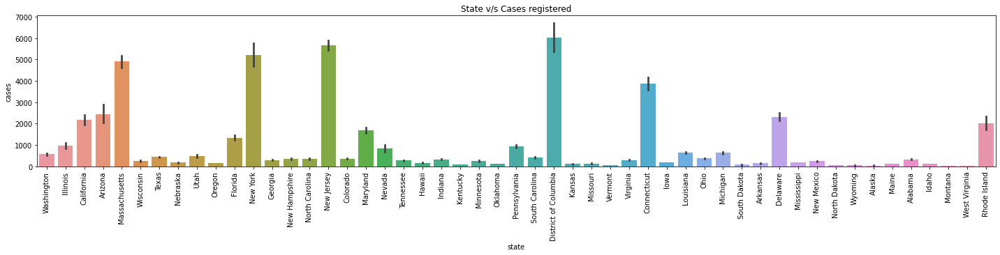

In [21]:
plt.figure(figsize=(20,5))
sns.barplot(x=df['state'],y = df['cases'], data=df)
plt.xticks( rotation=90)
plt.tight_layout()
plt.title('State v/s Cases registered')

In [35]:
enable_plotly_in_cell()
state_grp.iplot(kind='bar', x='state',y ='cases')


In [40]:
enable_plotly_in_cell()
county_grp.iplot(kind='bar', x='county',y ='cases')


In [48]:
enable_plotly_in_cell()
region_grp.iplot(kind='bar', x='region',y ='cases')


In [66]:
date_grp = df.groupby('date')['cases'].count().reset_index()

In [67]:
date_grp.head()

,date,cases
0,2020-01-21,1
1,2020-01-22,1
2,2020-01-23,1
3,2020-01-24,2
4,2020-01-25,3


In [68]:
enable_plotly_in_cell()
date_grp.iplot(kind='bar', x='date',y ='cases')


Text(0.5, 1.0, 'County v/s Cases registered')

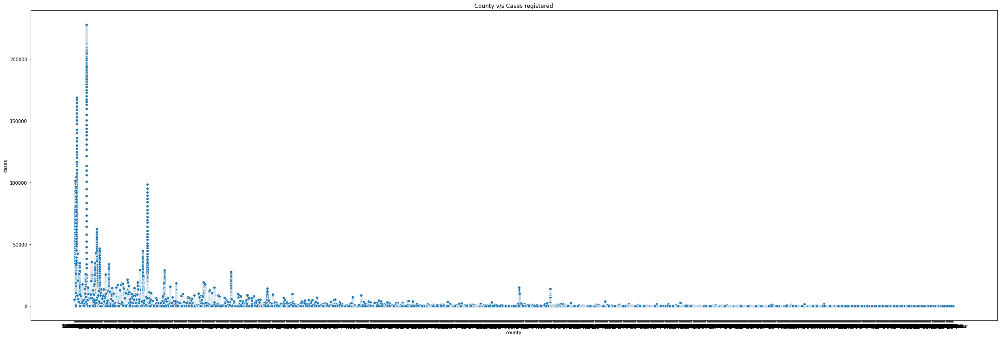

In [ ]:
plt.figure(figsize=(30,10))
sns.scatterplot(x=df['county'],y = df['cases'], data=df)
plt.tight_layout()
plt.title('County v/s Cases registered')

Text(0.5, 1.0, 'Regions v/s Cases registered')

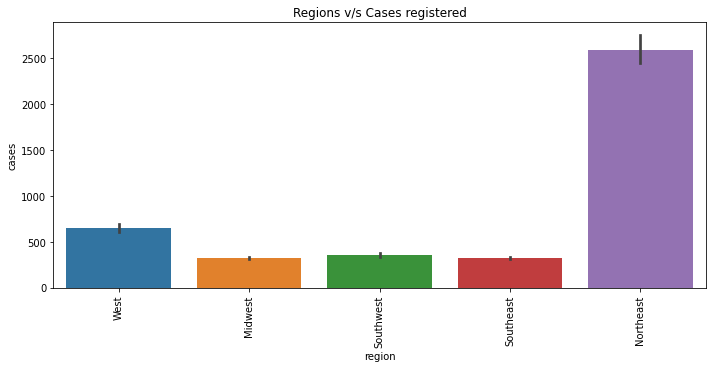

In [ ]:
plt.figure(figsize=(10,5))
sns.barplot(x=df['region'],y = df['cases'], data=df)
plt.xticks( rotation=90)
plt.tight_layout()
plt.title('Regions v/s Cases registered')

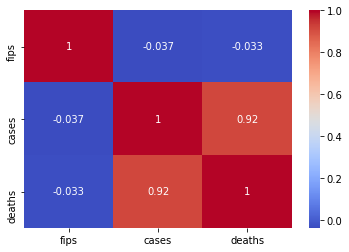

In [ ]:
sns.heatmap(df.corr(),annot=True, cmap='coolwarm')

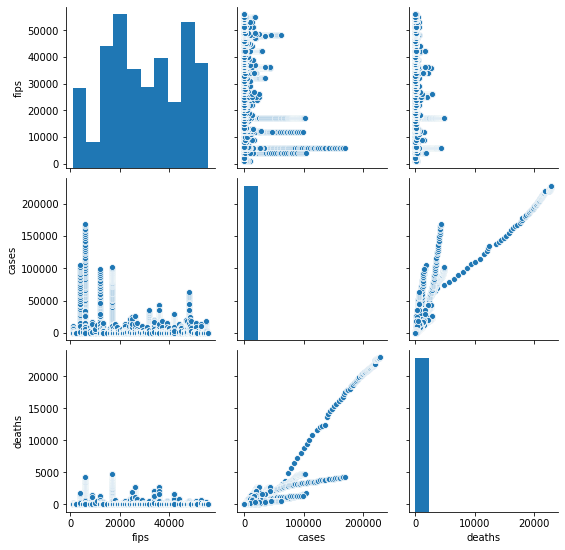

In [ ]:
sns.pairplot(df)

In [ ]:
region_cases = df.groupby('region')['cases'].count().reset_index()

In [ ]:
region_cases

,region,cases
0,Midwest,114661
1,Northeast,28857
2,Southeast,111434
3,Southwest,35252
4,West,38253


In [ ]:
df.dtypes

date      datetime64[ns]
county            object
state             object
fips             float64
cases              int64
deaths             int64
region            object
dtype: object

In [ ]:
df.isnull().sum().sort_values(ascending=False)

region    28214
fips        303
deaths        0
cases         0
state         0
county        0
date          0
dtype: int64

In [48]:
state_codes = {
    'District of Columbia' : 'dc','Mississippi': 'MS', 'Oklahoma': 'OK', 
    'Delaware': 'DE', 'Minnesota': 'MN', 'Illinois': 'IL', 'Arkansas': 'AR', 
    'New Mexico': 'NM', 'Indiana': 'IN', 'Maryland': 'MD', 'Louisiana': 'LA', 
    'Idaho': 'ID', 'Wyoming': 'WY', 'Tennessee': 'TN', 'Arizona': 'AZ', 
    'Iowa': 'IA', 'Michigan': 'MI', 'Kansas': 'KS', 'Utah': 'UT', 
    'Virginia': 'VA', 'Oregon': 'OR', 'Connecticut': 'CT', 'Montana': 'MT', 
    'California': 'CA', 'Massachusetts': 'MA', 'West Virginia': 'WV', 
    'South Carolina': 'SC', 'New Hampshire': 'NH', 'Wisconsin': 'WI',
    'Vermont': 'VT', 'Georgia': 'GA', 'North Dakota': 'ND', 
    'Pennsylvania': 'PA', 'Florida': 'FL', 'Alaska': 'AK', 'Kentucky': 'KY', 
    'Hawaii': 'HI', 'Nebraska': 'NE', 'Missouri': 'MO', 'Ohio': 'OH', 
    'Alabama': 'AL', 'Rhode Island': 'RI', 'South Dakota': 'SD', 
    'Colorado': 'CO', 'New Jersey': 'NJ', 'Washington': 'WA', 
    'North Carolina': 'NC', 'New York': 'NY', 'Texas': 'TX', 
    'Nevada': 'NV', 'Maine': 'ME'}

state_grp['state_code'] = state_grp['state'].apply(lambda x : state_codes[x])


In [ ]:
len(df['state'].unique())

51

In [ ]:
iplot(choromap)

In [ ]:
df['county'] = df.county.astype('category')
df['state'] = df.state.astype('category')
df['region'] = df.region.astype('category')

cat_columns = df.select_dtypes(['category']).columns.tolist()
for col in cat_columns:
    df[col] = df[col].cat.codes


In [ ]:
df.head()

,date,county,state,fips,cases,deaths,region,state_code
0,2020-01-21,1515,47,53061.0,1,0,4,WA
1,2020-01-22,1515,47,53061.0,1,0,4,WA
2,2020-01-23,1515,47,53061.0,1,0,4,WA
3,2020-01-24,389,13,17031.0,1,0,0,IL
4,2020-01-24,1515,47,53061.0,1,0,4,WA


In [ ]:
df.dtypes

date          datetime64[ns]
county                 int16
state                   int8
fips                 float64
cases                  int64
deaths                 int64
region                  int8
state_code            object
dtype: object

In [50]:
data = dict(type = 'choropleth',
            locations=state_grp['state_code'],
            locationmode = 'USA-states',
            colorscale = 'Portland',
            z = state_grp['cases'],
            colorbar = {'title':'No of cases'})

In [51]:
layout = dict(geo= {'scope':'usa'})
choromap = go.Figure(data=[data],layout = layout)


In [52]:
iplot(choromap)

In [ ]:
df.to_csv('/content/drive/My Drive/data/pre-pro.csv', index=False)

In [ ]:
df = pd.read_csv('/content/drive/My Drive/data/pre-pro.csv', parse_dates=['date'])

In [ ]:
df.shape

(356671, 8)

In [ ]:
df.head()

,date,county,state,fips,cases,deaths,region,state_code
0,2020-01-21,1515,47,53061.0,1,0,4,WA
1,2020-01-22,1515,47,53061.0,1,0,4,WA
2,2020-01-23,1515,47,53061.0,1,0,4,WA
3,2020-01-24,389,13,17031.0,1,0,0,IL
4,2020-01-24,1515,47,53061.0,1,0,4,WA


In [ ]:
df.isna().sum()

date          0
county        0
state         0
fips          0
cases         0
deaths        0
region        0
state_code    0
dtype: int64

In [ ]:
df['cases']

0           1
1           1
2           1
3           1
4           1
         ... 
356666    210
356667    264
356668    232
356669     44
356670      4
Name: cases, Length: 356671, dtype: int64

## Feature Engineering

In [ ]:
from stats

Using TensorFlow backend.


In [ ]:
df.describe()

,county,state,fips,cases,deaths,region
count,356671.000000,356671.000000,356671.000000,356671.000000,356671.000000,356671.000000
mean,917.957053,26.053739,30157.791489,591.362631,29.176647,1.352168
std,513.721169,14.394170,15321.088601,4527.553441,374.554438,1.478816
min,0.000000,0.000000,0.000000,1.000000,0.000000,-1.000000
25%,477.000000,14.000000,18105.000000,8.000000,0.000000,0.000000
50%,923.000000,25.000000,29089.000000,37.000000,1.000000,2.000000
75%,1344.000000,40.000000,45056.000000,182.000000,5.000000,2.000000
max,1828.000000,50.000000,56045.000000,227882.000000,22936.000000,4.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 356671 entries, 0 to 356670
Data columns (total 8 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   date        356671 non-null  datetime64[ns]
 1   county      356671 non-null  int64         
 2   state       356671 non-null  int64         
 3   fips        356671 non-null  float64       
 4   cases       356671 non-null  int64         
 5   deaths      356671 non-null  int64         
 6   region      356671 non-null  int64         
 7   state_code  356671 non-null  object        
dtypes: datetime64[ns](1), float64(1), int64(5), object(1)
memory usage: 21.8+ MB


## Model Architecture

1. LSTM with 100 neurons in the first layer
2. 1 neuron in output layer for predicting `cases`
3. Input shape
4. Model will fit for epochs and batch size